<a href="https://colab.research.google.com/github/ChristiMoncrief/AAA-521_Group6_FinalProject/blob/main/AAI521_Team6_Final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# AAI521-Final Project: Team 6
- Christi Moncrief  
- Adam Graves   
- Reed Oken

######################################################################################
##Edge IoT Device for Detecting and Counting People in a Region Of Interest
######################################################################################

In [19]:
#@title 1: Install ultralytics for YOLO library
!pip install ultralytics

NotImplementedError: ignored

In [ ]:
#@title 1.1: Loading related libraries
import cv2
from ultralytics import YOLO

import matplotlib.pyplot as plt

import pandas as pd
import numpy as np
import os
import subprocess
from tqdm.notebook import tqdm

from IPython.display import Video, display, HTML, Javascript, Image
import datetime

from base64 import b64encode, b64decode

from google.colab.output import eval_js
from google.colab.patches import cv2_imshow

from google.colab import drive
drive.mount('/content/drive')

In [ ]:
#@title 2: Loading a YOLO model
model = YOLO('yolov8x.pt')

# Enhance the YOLO model with additional knowledge transfer to help with unique lighting or busy ROI
model.train(data="coco128.yaml", epochs=3)  # train the model

#geting names from classes
dict_classes = model.model.names

In [20]:
#@title 2.1: Load video (emulate capture)
# Load video (emulate capture)
video_name = 'City_Hall-IOT1'
encoding_type = '.mp4'
video_folder = '/content/drive/MyDrive/AAI-521/Final/Test/'

video_path = video_folder + video_name + encoding_type
video = cv2.VideoCapture(video_path)

In [21]:
#@title 3: Define required functions for video processing
# process frames
def risize_frame(frame, scale_percent):
    """Function to resize frame"""
    # resize image
    width = int(frame.shape[1] * scale_percent / 100)
    height = int(frame.shape[0] * scale_percent / 100)
    dim = (width, height)
    # resize image
    resized = cv2.resize(frame, dim, interpolation = cv2.INTER_AREA)
    return resized

# Filter the history of tracked objects
def filter_tracks(centers, patience):
    """Function to filter the history of tracked objects"""
    filter_dict = {}
    for k, i in centers.items():
        d_frames = i.items()
        filter_dict[k] = dict(list(d_frames)[-patience:])

    return filter_dict

# Update tracked objects
def update_tracking(centers_old,obj_center, thr_centers, lastKey, frame, frame_max):
    is_new = 0 # Reset count
    lastpos = [(k, list(center.keys())[-1], list(center.values())[-1]) for k, center in centers_old.items()]
    lastpos = [(i[0], i[2]) for i in lastpos if abs(i[1] - frame) <= frame_max] # Check position within each frame
    # Calculating distance from existing centers points - calculate if same or new person
    previous_pos = [(k,obj_center) for k,centers in lastpos if (np.linalg.norm(np.array(centers) - np.array(obj_center)) < thr_centers)]
    # if distance less than a threshold, it will update its positions
    if previous_pos:
        id_obj = previous_pos[0][0]
        centers_old[id_obj][frame] = obj_center

    # Else a new ID will be set to the given object
    else:
        if lastKey:
            last = lastKey.split('D')[1]
            id_obj = 'ID' + str(int(last)+1)
        else:
            id_obj = 'ID0'

        is_new = 1
        centers_old[id_obj] = {frame:obj_center}
        lastKey = list(centers_old.keys())[-1]

    return centers_old, id_obj, is_new, lastKey

def plt_pretty_image(image, label=None):
    """Function to display an image using matplotlib.pyplot.imshow with plt graphing features (Grid and x/y ticks removed)"""
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(image, cmap='gray')
    plt.xlabel(label)

def video_to_base64(file_path):
    with open(file_path, 'rb') as video_file:
        encoded_string = b64encode(video_file.read()).decode()
    return encoded_string

In [22]:
#@title 3.1: Configurations for ROI objects

# Scaling percentage of original frame
scale_percent = 100
# model confidence level
conf_level = 0.6
# Threshold of centers ( old\new)
thr_centers = 30 # Pixles between objects (modify per test MP4)
#Number of max frames to consider a object lost
frame_max = 5
# Number of max tracked centers stored
patience = 100
# ROI area color transparency
alpha = 0.2

In [23]:
#@title 4.1: Set person class to detect in YOLO
# Objects to detect Yolo
class_IDS = [0] #Persons

# Auxiliary variables
centers_old = {}
obj_id = 0
end = []
frames_list = []
count_p = 0
lastKey = ''

In [24]:
#@title 4.2: Settings for input of video
# Original informations of video
height = int(video.get(cv2.CAP_PROP_FRAME_HEIGHT))
width = int(video.get(cv2.CAP_PROP_FRAME_WIDTH))
fps = video.get(cv2.CAP_PROP_FPS)
frame_count = int(video.get(cv2.CAP_PROP_FRAME_COUNT))
print(f'Original dimensions: {(width, height)}')
print(f'Original FPS: {fps}')

# Scaling Video for better performance
if scale_percent != 100:
    print('Scaling change may cause errors in pixels lines ')
    width = int(width * scale_percent / 100)
    height = int(height * scale_percent / 100)
    print(f'Dimension scaled: {(width, height)}')

Original dimensions: (1920, 1080)
Original FPS: 25.0


In [25]:
#@title 4.3: Settings on video output
# Settings for video output
output_video_path = video_name + '_result.mp4'
VIDEO_CODEC = "MP4V" #set to MP4 codec
tmp_output_path = 'tmp_' + output_video_path

fourcc = cv2.VideoWriter_fourcc(*VIDEO_CODEC)
output_video = cv2.VideoWriter(
    tmp_output_path,
    fourcc=fourcc,
    fps=fps,
    frameSize=(width, height)
)

In [26]:
#@title 4.4 ROI area setup
custom_roi = False

# default full frame
if not custom_roi:
    x_min = 0
    x_max = x_min + width
    y_min = 0
    y_max = y_min + height
else:
    x_min = 100
    x_max = 500
    y_min = 50
    y_max = 300

blur_factor = 0

# font scaling
font_size = min(width, height) // 300
font_thickness = max(6, font_size // 2)

In [27]:
#@title 5: Executing Recognition in an ROI section

# Initialize DataFrame to store results
results_df = pd.DataFrame(columns=['Frame', 'Timestamp', 'People_Count', 'Confidence_Scores'])

for i in tqdm(range(frame_count)):

    # reading frame from video
    ret, frame = video.read()

    if not ret:
        continue

    # Applying resizing of read frame
    if scale_percent != 100:
        frame  = risize_frame(frame, scale_percent)

    # Apply Gaussian Blur to the frame
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    frame = cv2.GaussianBlur(frame, (3, 3), blur_factor)

    # Setup ROI
    area_roi = [np.array([(x_min,y_min),(x_min,y_max),(x_max,y_max),(x_max,y_min)], np.int32)]
    roi_frame = frame[y_min:y_max, x_min:x_max]

    # Getting predictions
    y_hat = model.predict(roi_frame, conf = conf_level, classes = class_IDS, device = 0, verbose = False)

    # Update total count of people
    count_p = 0
    confidence_scores = [] #Set for Excel output

    # Fetch current time
    current_time = datetime.datetime.now()
    time_str = current_time.strftime("%H:%M:%S")  # Format time as HH:MM:SS

    text_size = cv2.getTextSize(time_str, cv2.FONT_HERSHEY_SIMPLEX, font_size/2, font_thickness//2)[0]
    text_x = int(frame.shape[1] - text_size[0] - (frame.shape[1] * 0.01))
    text_y = int(frame.shape[0] * 0.1)

    cv2.putText(frame, time_str, (text_x, text_y),
                cv2.FONT_HERSHEY_SIMPLEX, font_size/2, (255, 255, 255), font_thickness//2)

    # Getting the bounding boxes, confidence and classes of the recognize objects in the current frame.
    boxes_data = y_hat[0].boxes.xyxy.cpu().numpy() #Move into CPU memory
    confidences = y_hat[0].boxes.conf.cpu().numpy()
    classes = y_hat[0].boxes.cls.cpu().numpy()

    # Storing the above information in a dataframe, setting the min and max values
    positions_frame = pd.DataFrame(boxes_data, columns=['xmin', 'ymin', 'xmax', 'ymax'])
    positions_frame['conf'] = confidences
    positions_frame['class'] = classes

    #Translating the numeric class labels to text
    labels = [dict_classes[i] for i in classes]

    #handle tracking logic
    for ix, row in enumerate(positions_frame.iterrows()):
        xmin, ymin, xmax, ymax, confidence, category = row[1].astype('int')

        count_p += 1

        confidence_scores.append(confidence) #Append data for Excel file
        # Calculating the center of the bounding box
        center_x, center_y = int(((xmax + xmin) / 2)), int(((ymax + ymin) / 2))
        # Drawing bounding box for every detection
        cv2.rectangle(roi_frame, (xmin, ymin), (xmax, ymax), (0, 0, 255), 2)

        # Updating the tracking for each object
        centers_old, id_obj, is_new, lastKey = update_tracking(centers_old, (center_x, center_y), thr_centers, lastKey, i, frame_max)

        # Drawing additional tracking info (like circles) if needed (New)
        for center_x,center_y in centers_old[id_obj].values():
            cv2.circle(roi_frame, (center_x,center_y), 5,(0,255,0),-1)  # Using a different color for clarity

        #Updating people in ROI
        count_p+=is_new

        #Drawing above the bounding-box the name of class recognized.
        cv2.putText(img=roi_frame,
            text=id_obj + ':' + str(np.round(confidences[ix], 2)),
            org=(xmin, ymin - 40),  # Adjust this value to position the text higher
            fontFace=cv2.FONT_HERSHEY_TRIPLEX,
            fontScale=0.9,
            color=(0, 0, 255),
            thickness=1)


    count_str = f'No. of People in ROI: {count_p}'
    baseline = cv2.getTextSize(count_str, cv2.FONT_HERSHEY_SIMPLEX, font_size, font_thickness)[1]
    text_x = int(frame.shape[1] * 0.05)
    text_y = int(frame.shape[0] * 0.1) + baseline

    cv2.putText(img=frame, text=count_str,
                org=(text_x,text_y), fontFace=cv2.FONT_HERSHEY_SIMPLEX,
                fontScale=font_size, color=(255, 255, 255), thickness=font_thickness)


    # Append results for this frame to DataFrame (Excel)
    results_df = results_df.append({'Frame': i, 'Timestamp': time_str, 'People_Count': count_p, 'ID': lastKey}, ignore_index=True)

    # Filtering tracks history
    centers_old = filter_tracks(centers_old, patience)

    #Drawing the ROI area
    overlay = frame.copy() # make a copy of the original frame

    cv2.polylines(overlay, pts = area_roi, isClosed = True, color=(255, 0, 0),thickness=2)
    cv2.fillPoly(overlay, pts = area_roi, color = (255,255,0))
    frame = cv2.addWeighted(overlay, alpha,frame , 1 - alpha, 0)

    #Saving frames in a list
    frames_list.append(frame)
    #saving transformed frames in a output video formaat
    output_video.write(frame)

# After processing all frames, export the DataFrame to Excel
results_df.to_excel('/content/people_count.xlsx', index=False)

#Releasing the video
output_video.release()

  0%|          | 0/341 [00:00<?, ?it/s]

In [28]:
#@title 5.1: Process Video and Audio
# Check for Existing Output File and Remove if Present
if os.path.exists(output_video_path):
    os.remove(output_video_path)
# Process video and audio file
subprocess.run(
    ["ffmpeg",  "-i", tmp_output_path,"-crf","18","-preset","veryfast","-hide_banner","-loglevel","error","-vcodec","libx264",output_video_path])
os.remove(tmp_output_path)

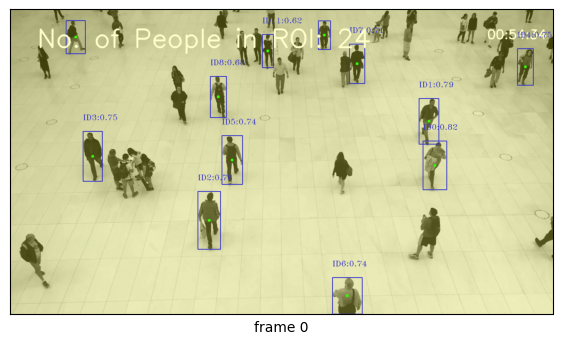

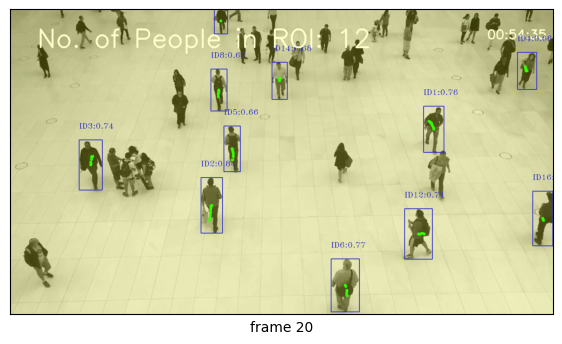

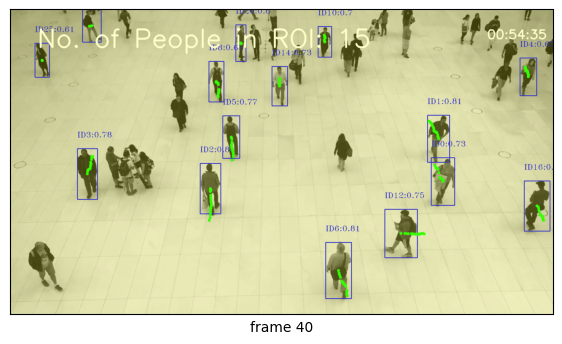

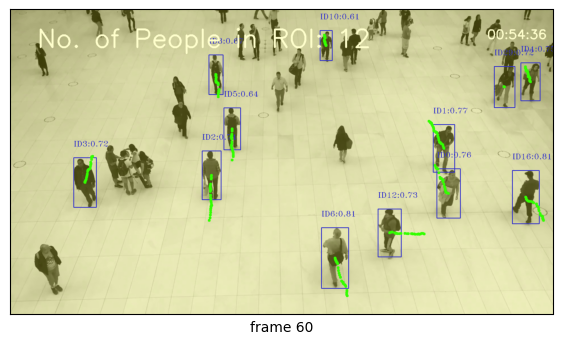

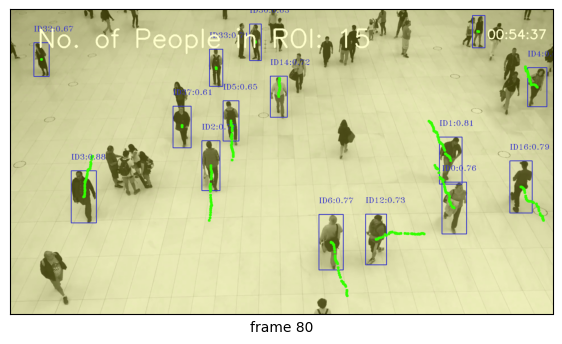

...

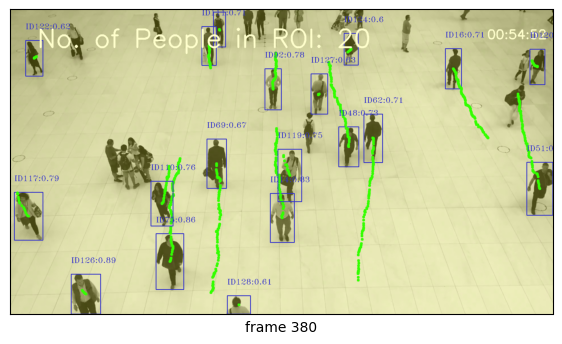

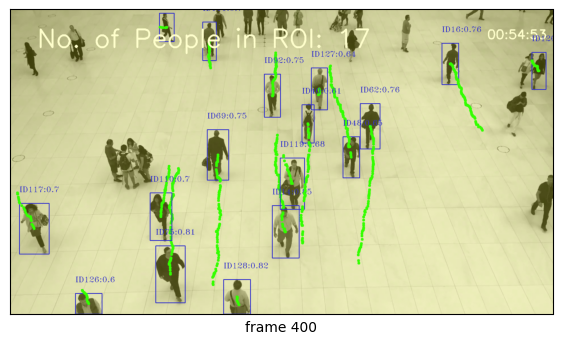

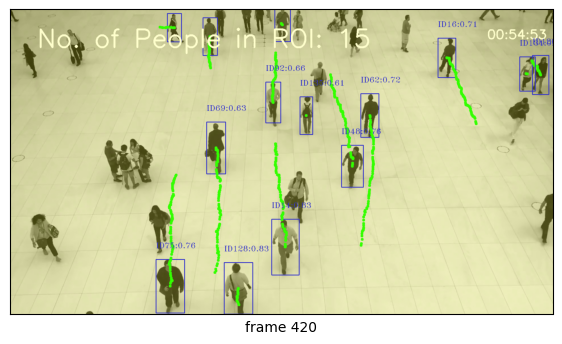

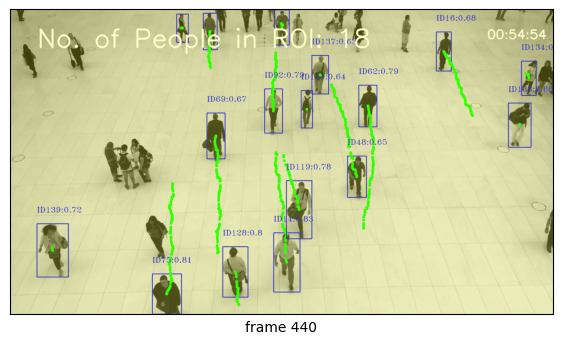

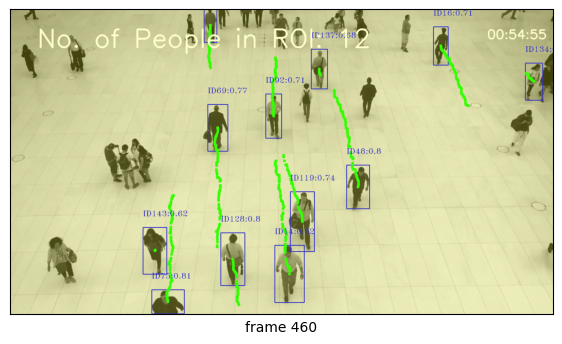

In [29]:
#@title 5.2: Display of people and results _ Testing
frames_to_display = 24

for i in range(frames_to_display):
    frame = frames_list[i*10].copy()

    plt.figure(figsize=(7, 5))
    plt_pretty_image(frame, f'frame {i*20}')
    plt.show()

In [30]:
#@title Monitoring: Play the processed MP4
# preview output video
video_tag = f"""
<video width={width/2} height={height/2} controls>
    <source src="data:video/mp4;base64,{video_to_base64(output_video_path)}" type="video/mp4">
</video>
"""

In [31]:
HTML(video_tag)

In [32]:
# Assuming the CSV file is named 'count_data.csv'
df = pd.read_excel('/content/drive/MyDrive/AAI-521/Final/Test/Score-ManualCount-t6.xlsx')

# Initialize counters
TP = 0
FP = 0
FN = 0

# Calculate TP, FP, and FN
for index, row in df.iterrows():
    system_count = row['System Count']
    manual_count = row['M. Counted']

    TP += min(system_count, manual_count)
    FP += max(0, system_count - manual_count)
    FN += max(0, manual_count - system_count)

# Calculate Precision, Recall, and F1 Score
precision = TP / (TP + FP) if TP + FP > 0 else 0
recall = TP / (TP + FN) if TP + FN > 0 else 0
f1_score = 2 * (precision * recall) / (precision + recall) if precision + recall > 0 else 0
#Print out the values
print("SCORE VALUES")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1_score:.4f}")

SCORE VALUES
Precision: 0.9948
Recall: 0.7265
F1 Score: 0.8397


#This section is for emulating a real-time Camera sensor in the IoT

In [33]:
#@title Installing required packages and testing the model
# import dependencies
from IPython.display import display, Javascript, Image
from google.colab.output import eval_js
from google.colab.patches import cv2_imshow
from base64 import b64decode, b64encode
import cv2
import numpy as np
import PIL
import io
import html
import time
import matplotlib.pyplot as plt
%matplotlib inline

In [34]:
#Open real-time camera capture with YOLO Object Detection
# Load the YOLOv8 model
model = YOLO("yolov8n.pt")  # Adjust the model path as necessary
dict_classes = model.model.names  # Class names

# Initialize camera stream
cap = cv2.VideoCapture(0)  # Use appropriate index or URL for your camera

try:
    while True:
        # Read frame from camera
        ret, frame = cap.read()
        if not ret:
            print("Error: failed to capture image")
            break

        # Perform detection
        results = model.predict(frame)

        # Draw bounding boxes and labels
        for detection in results.xyxy[0]:
            # Extract data
            xmin, ymin, xmax, ymax, conf, cls = detection
            label = dict_classes[int(cls)]

            # Draw bounding box
            cv2.rectangle(frame, (int(xmin), int(ymin)), (int(xmax), int(ymax)), (0, 255, 0), 2)
            # Draw label
            cv2.putText(frame, f"{label} {conf:.2f}", (int(xmin), int(ymin)-10),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

        # Display the frame
        cv2.imshow("Camera Feed", frame)

        # Break loop on specific key press, e.g., 'q'
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break
finally:
    cap.release()
    cv2.destroyAllWindows()


Error: failed to capture image
